In [1]:
# Import Libraries

import pandas as pd  
import seaborn as sns
import numpy as np

import matplotlib  
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12, 8) # adjusts the configureation of the plots created   

# read the data
df = pd.read_csv(r'C:\dev\PythonProject\Correlation in python\movies.csv')        

In [58]:
# to display dataframe in scrollable format
from IPython.display import display, HTML

def display_scrollable(df, height=300):
    display(HTML(f"""
    <div style="height:{height}px; overflow-y:auto; border:1px solid #ccc">
      {df.to_html()}
    </div>
    """))


In [59]:
# Data display
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,"(8, 9]",1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,"(5, 6]",1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,"(8, 9]",1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,"(7, 8]",1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,"(7, 8]",1980


In [3]:
# Looking for missing Data
for col in df.columns:
    percent_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, percent_missing))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [8]:
# viewing rows with any missing values
df[df.isnull().any(axis=1)]

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
16,Fame,R,Drama,1980,"May 16, 1980 (United States)",6.6,21000.0,Alan Parker,Christopher Gore,Eddie Barth,United States,NaN,21202829.0,Metro-Goldwyn-Mayer (MGM),134.0
19,Stir Crazy,R,Comedy,1980,"December 12, 1980 (United States)",6.8,26000.0,Sidney Poitier,Bruce Jay Friedman,Gene Wilder,United States,NaN,101300000.0,Columbia Pictures,111.0
24,Urban Cowboy,PG,Drama,1980,"June 6, 1980 (United States)",6.4,14000.0,James Bridges,Aaron Latham,John Travolta,United States,NaN,46918287.0,Paramount Pictures,132.0
25,Altered States,R,Horror,1980,"December 25, 1980 (United States)",6.9,33000.0,Ken Russell,Paddy Chayefsky,William Hurt,United States,NaN,19853892.0,Warner Bros.,102.0
26,Little Darlings,R,Comedy,1980,"March 21, 1980 (United States)",6.5,5100.0,Ron Maxwell,Kimi Peck,Tatum O'Neal,United States,NaN,34326249.0,Stephen Friedman/Kings Road Productions,96.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0


In [ ]:
# checking the number of misssing values
print(df[df.isnull().any(axis = 1)].shape[0])

2247


In [16]:
# checking for missing values in specific columns
df.isnull().sum()[df.isnull().sum()>0]

rating        77
released       2
score          3
votes          3
writer         3
star           1
country        3
budget      2171
gross        189
company       17
runtime        4
dtype: int64

In [15]:
# general statistics of missing values
print('Number of missing values in budget: ',df['budget'].isnull().sum())
print('Number of missing values in gross: ',df['gross'].isnull().sum())

print(df['budget'].describe())
print(df['gross'].describe())

Number of missing values in budget:  2171
Number of missing values in gross:  189
count    5.497000e+03
mean     3.558988e+07
std      4.145730e+07
min      3.000000e+03
25%      1.000000e+07
50%      2.050000e+07
75%      4.500000e+07
max      3.560000e+08
Name: budget, dtype: float64
count    7.479000e+03
mean     7.850054e+07
std      1.657251e+08
min      3.090000e+02
25%      4.532056e+06
50%      2.020576e+07
75%      7.601669e+07
max      2.847246e+09
Name: gross, dtype: float64


In [25]:
# Data types for columns
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

CLEANING THE DATA

In [31]:
# 1. Identifying the rows with samll number of missing values
# df[df['score'].isnull()]
df[df['votes'].isnull()]
# df[df['runtime'].isnull()]


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime


In [26]:
# 2. Manually filling small number of missing vaalues of columns
df.loc[7661,'score'] = 6.9
df.loc[7661,'votes'] = 23

df.loc[7666,'score'] = 8.4
df.loc[7666, 'votes'] = 9 

df.loc[5728,'runtime'] = 103
df.loc[5730,'runtime'] = 119
df.loc[6195, 'runtime'] = 91
df.loc[7665, 'runtime'] = 110

# 3. Dropping rows with missing values
df.drop(7662, inplace=True)

In [ ]:
# 4. Filling unknown for datatype = objects
df['released'].fillna('Unknown', inplace=True)
df['country'].fillna('Unknown', inplace=True)
df['director'].fillna('Unknown', inplace=True)
df['star'].fillna('Unknown', inplace=True)
df['company'].fillna('Unknown', inplace=True)
df['rating'].fillna('Unknown', inplace=True)
df['writer'].fillna('Unknown', inplace=True)

C:\Users\aavas\AppData\Local\Temp\ipykernel_25564\4130475676.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['released'].fillna('Unknown', inplace=True)
C:\Users\aavas\AppData\Local\Temp\ipykernel_25564\4130475676.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For examp

In [ ]:
# 5. Uisng median of score to fill missssing budget and gross valuess
# grouping by score ranges instead of exxact values
df['score_range'] = pd.cut(df['score'], bins=[0,1,2,3,4,5,6,7,8,9,10])

# Filling columns based on score_range
df['budget'].fillna(df.groupby('score_range')['budget'].transform('median'),inplace=True)
df['gross'].fillna(df.groupby('score_range')['gross'].transform('median'), inplace=True)

C:\Users\aavas\AppData\Local\Temp\ipykernel_25564\3581614716.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df['budget'].fillna(df.groupby('score_range')['budget'].transform('median'),inplace=True)
C:\Users\aavas\AppData\Local\Temp\ipykernel_25564\3581614716.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['budget'].fillna(df.g

In [ ]:
# Checking after making the changes
df[df.isnull().any(axis=1)]

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range


In [42]:
# change data type of a column
df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')

In [94]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,6586,6,6,1980,1705,8.4,927000.0,2589,4013,1046,54,19000000,46998772,2320,146.0,"(8, 9]",0
1,5573,6,1,1980,1492,5.8,65000.0,2269,1631,326,55,4500000,58853106,731,104.0,"(5, 6]",0
2,5142,4,0,1980,1771,8.7,1200000.0,1111,2566,1744,55,18000000,538375067,1540,124.0,"(8, 9]",0
3,286,4,4,1980,1492,7.7,221000.0,1301,1999,2245,55,3500000,83453539,1812,88.0,"(7, 8]",0
4,1027,6,4,1980,1543,7.3,108000.0,1054,520,409,55,6000000,39846344,1777,98.0,"(7, 8]",0


In [ ]:
# in the datrset being used the years in the 'year' column does not  match with the 'released' column
# creating a new column 'year' from the 'released' column
df['correct_year'] = df['released'].str.extract(r'(\d{4})')
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,"(8, 9]",1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,"(5, 6]",1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,"(8, 9]",1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,"(7, 8]",1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,"(7, 8]",1980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,Unknown,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000,10326507,Unknown,90.0,"(3, 4]",2020
7664,Dream Round,Unknown,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,20000000,12506362,Cactus Blue Entertainment,90.0,"(4, 5]",2020
7665,Saving Mbango,Unknown,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750,17394472,Embi Productions,110.0,"(5, 6]",2020
7666,It's Just Us,Unknown,Drama,2020,"October 1, 2020 (United States)",8.4,9.0,James Randall,James Randall,Christina Roz,United States,15000,83704069,Unknown,120.0,"(8, 9]",2020


In [65]:
# ordering it by grossss revenue
display_scrollable(df.sort_values(by='gross', inplace=False, ascending=False ))

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162.0,"(7, 8]",2009
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181.0,"(8, 9]",2019
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194.0,"(7, 8]",1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138.0,"(7, 8]",2015
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149.0,"(8, 9]",2018
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,222000.0,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118.0,"(6, 7]",2019
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,593000.0,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124.0,"(6, 7]",2015
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,1300000.0,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143.0,"(7, 8]",2012
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,370000.0,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137.0,"(7, 8]",2015
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,148000.0,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103.0,"(6, 7]",2019


In [ ]:
pd.set_option('display.max_rows', None)  # to display all rows in the dataframe


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.400000,927000.000000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.000000,"(8, 9]",1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.800000,65000.000000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.000000,"(5, 6]",1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.700000,1200000.000000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.000000,"(8, 9]",1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.700000,221000.000000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.000000,"(7, 8]",1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.300000,108000.000000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.000000,"(7, 8]",1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.400000,123000.000000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.000000,"(6, 7]",1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.900000,188000.000000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.000000,"(7, 8]",1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.200000,330000.000000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.000000,"(8, 9]",1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.800000,101000.000000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.000000,"(6, 7]",1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.000000,10000.000000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.000000,"(6, 7]",1980


In [54]:
# checking duplicates
df[df.duplicated()]

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year


In [60]:
# Dropping duplicates if any
display_scrollable(df.drop_duplicates())

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,"(8, 9]",1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,"(5, 6]",1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,"(8, 9]",1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,"(7, 8]",1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,"(7, 8]",1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.0,"(6, 7]",1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,"(7, 8]",1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,"(8, 9]",1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,"(6, 7]",1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.0,"(6, 7]",1980


FINDING CORRELATIONNS IN THE DATA    

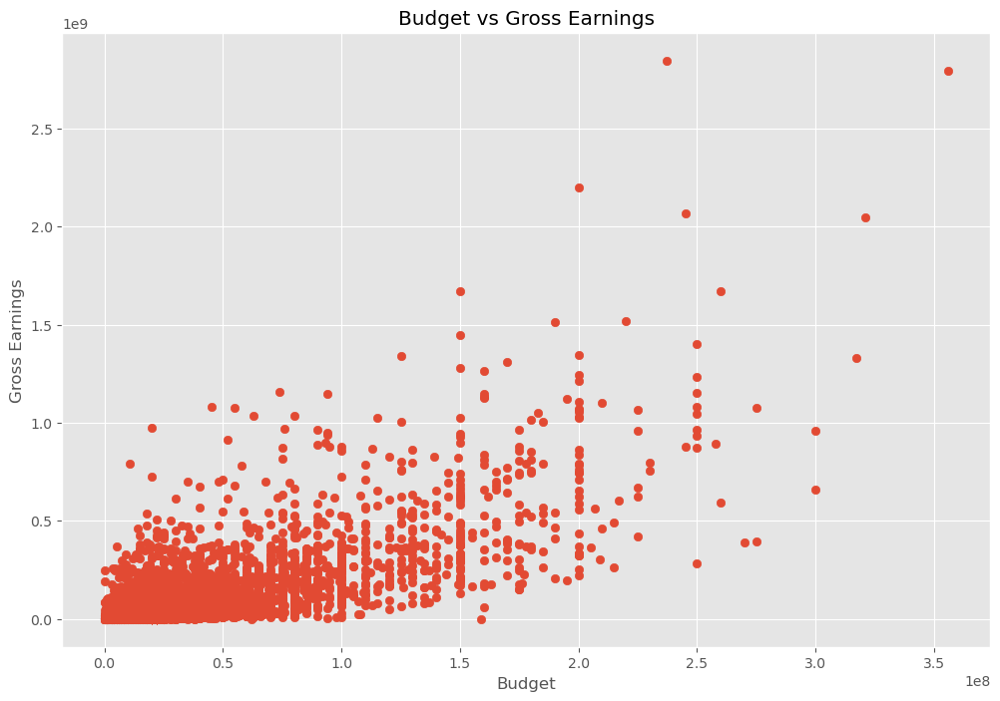

In [62]:
# SCATTER PLOT WITH BUDGET VS GROSS
plt.scatter(x='budget', y='gross', data=df) 
plt.title('Budget vs Gross Earnings')
plt.xlabel('Budget')
plt.ylabel('Gross Earnings')
plt.show()

<Axes: xlabel='budget', ylabel='gross'>

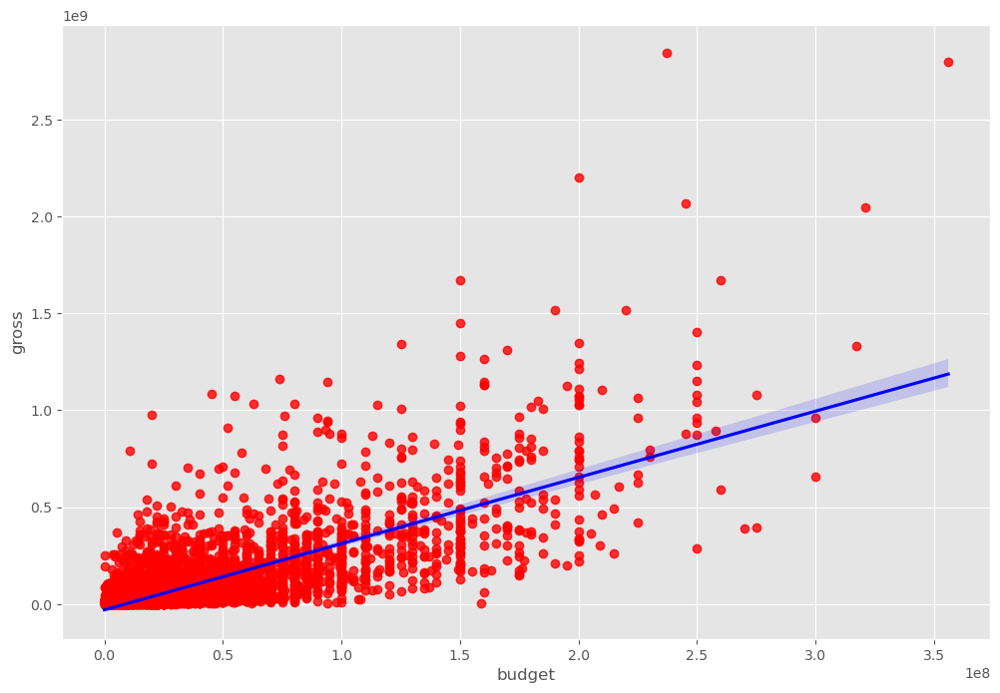

In [70]:
# plotting budget vs gross using seaborn
sns.regplot(x='budget', y='gross', data=df, scatter_kws={"color":"red"}, line_kws={"color":"blue"})

In [78]:
# looking for correlations
df.corr(method = 'spearman', numeric_only = True)

,year,score,votes,budget,gross,runtime
year,1.000000,0.099511,0.468681,0.258410,0.288616,0.143301
score,0.099511,1.000000,0.427349,-0.023859,0.130003,0.399919
votes,0.468681,0.427349,1.000000,0.372347,0.723568,0.289382
budget,0.258410,-0.023859,0.372347,1.000000,0.514713,0.265864
gross,0.288616,0.130003,0.723568,0.514713,1.000000,0.244220
runtime,0.143301,0.399919,0.289382,0.265864,0.244220,1.000000


we find from the correlation matrix that budget and gross have high correlation

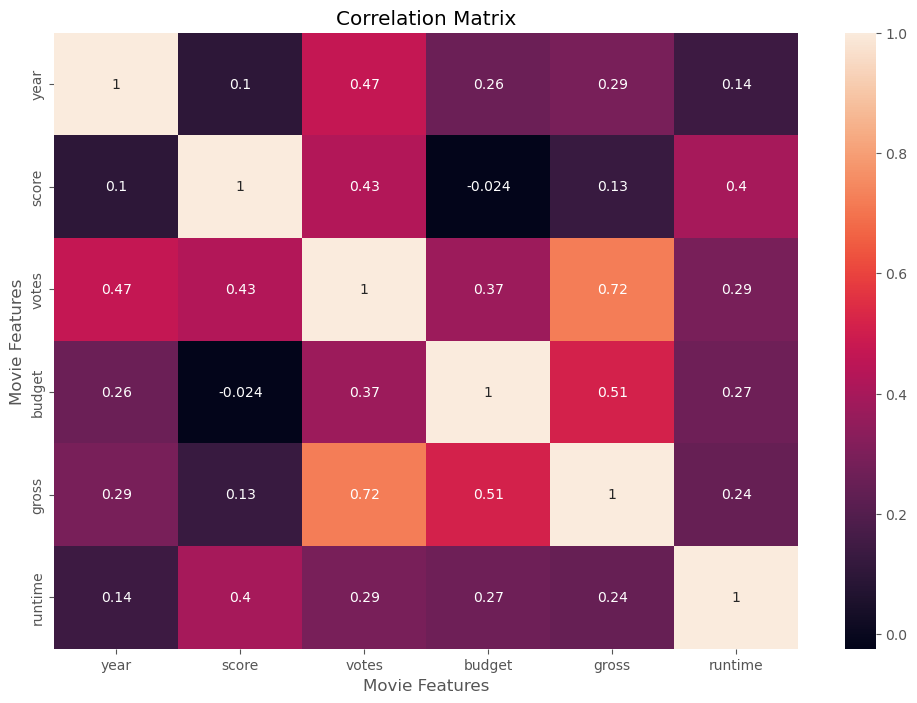

In [82]:
correlation_matrix = df.corr(method = 'spearman', numeric_only = True)
sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matrix')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.show()

In [95]:
# looking at company (assumig a company has high revenue movie production)
# since 'company' column is a non umeric column, it nneeds to be convert to a numeric format
df_numerized = df

for col_name in df_numerized.columns:
    if df_numerized[col_name].dtype == 'object':
        df_numerized[col_name] = df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes # Convert categorical data to numeric
display_scrollable(df_numerized.head())  

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,score_range,correct_year
0,6586,6,6,1980,1705,8.4,927000.0,2589,4013,1046,54,19000000,46998772,2320,146.0,"(8, 9]",0
1,5573,6,1,1980,1492,5.8,65000.0,2269,1631,326,55,4500000,58853106,731,104.0,"(5, 6]",0
2,5142,4,0,1980,1771,8.7,1200000.0,1111,2566,1744,55,18000000,538375067,1540,124.0,"(8, 9]",0
3,286,4,4,1980,1492,7.7,221000.0,1301,1999,2245,55,3500000,83453539,1812,88.0,"(7, 8]",0
4,1027,6,4,1980,1543,7.3,108000.0,1054,520,409,55,6000000,39846344,1777,98.0,"(7, 8]",0


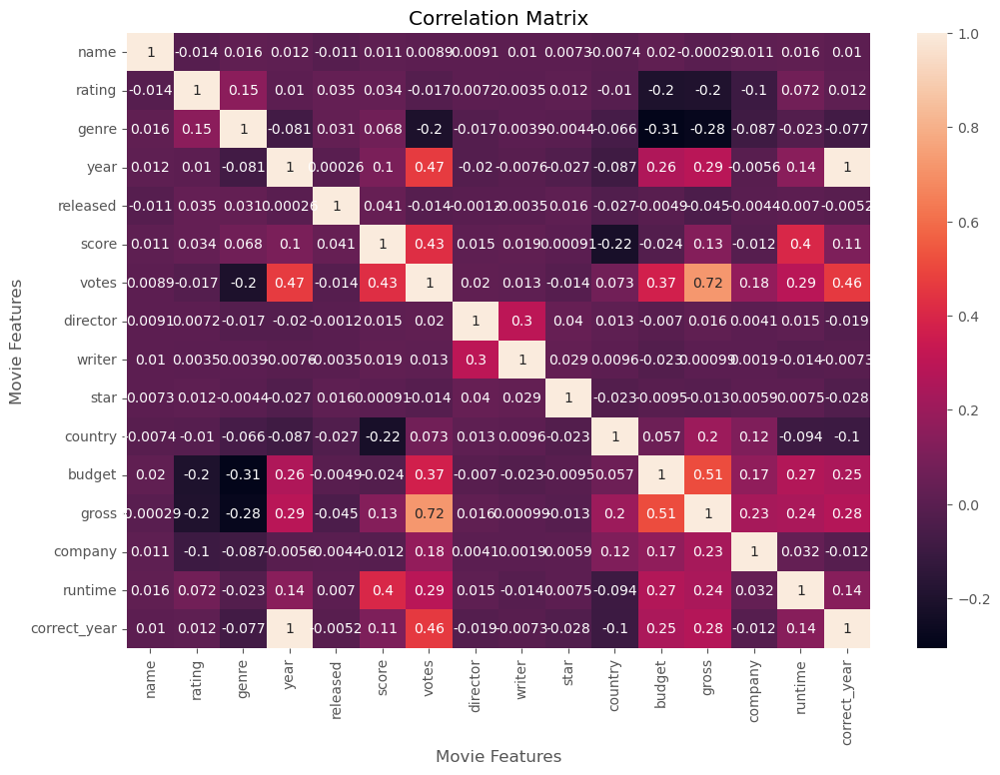

In [85]:
correlation_matrix = df_numerized.corr(method = 'spearman', numeric_only = True)
sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matrix')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.show()

In [88]:
df_numerized.corr(numeric_only=True)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,correct_year
name,1.000000,-0.012843,0.016579,0.011162,-0.010622,0.016965,0.013131,0.009236,0.010273,0.007079,-0.010434,0.021233,0.006698,0.010171,0.010643,0.009937
rating,-0.012843,1.000000,0.136909,0.032982,0.025134,0.022032,-0.004170,0.012414,-0.000795,0.001739,-0.012018,-0.149370,-0.130717,-0.092968,0.058762,0.034540
genre,0.016579,0.136909,1.000000,-0.080984,0.030561,0.028245,-0.145408,-0.015419,0.006463,-0.004878,-0.035712,-0.327704,-0.233391,-0.069838,-0.052641,-0.077936
year,0.011162,0.032982,-0.080984,1.000000,-0.000116,0.098522,0.222599,-0.020588,-0.007549,-0.027590,-0.069706,0.290952,0.259591,-0.011706,0.120961,0.996395
released,-0.010622,0.025134,0.030561,-0.000116,1.000000,0.042505,0.016009,-0.001420,-0.003522,0.015631,-0.021747,0.010896,0.000632,-0.007764,0.001078,-0.005702
score,0.016965,0.022032,0.028245,0.098522,0.042505,1.000000,0.408862,0.009454,0.019597,-0.001016,-0.134260,0.062006,0.186930,-0.004308,0.399525,0.106811
votes,0.013131,-0.004170,-0.145408,0.222599,0.016009,0.408862,1.000000,0.000284,0.000369,-0.019481,0.073457,0.459416,0.632050,0.130635,0.309076,0.217951
director,0.009236,0.012414,-0.015419,-0.020588,-0.001420,0.009454,0.000284,1.000000,0.299393,0.039711,0.018068,-0.004146,-0.014654,0.004395,0.017502,-0.020181
writer,0.010273,-0.000795,0.006463,-0.007549,-0.003522,0.019597,0.000369,0.299393,1.000000,0.028591,0.014588,-0.031488,-0.023086,0.001993,-0.004193,-0.007276
star,0.007079,0.001739,-0.004878,-0.027590,0.015631,-0.001016,-0.019481,0.039711,0.028591,1.000000,-0.015023,-0.019017,-0.001954,0.008133,0.008642,-0.027967


In [ ]:
# organizig to see the highest correlation
corr_mat = df_numerized.corr(numeric_only=True)
corr_pairs = corr_mat.unstack()
corr_pairs

name          name            1.000000
              rating         -0.012843
              genre           0.016579
              year            0.011162
              released       -0.010622
              score           0.016965
              votes           0.013131
              director        0.009236
              writer          0.010273
              star            0.007079
              country        -0.010434
              budget          0.021233
              gross           0.006698
              company         0.010171
              runtime         0.010643
              correct_year    0.009937
rating        name           -0.012843
              rating          1.000000
              genre           0.136909
              year            0.032982
              released        0.025134
              score           0.022032
              votes          -0.004170
              director        0.012414
              writer         -0.000795
              star       

In [92]:
sorted_pairs = corr_pairs.sort_values()
sorted_pairs

genre         budget         -0.327704
budget        genre          -0.327704
genre         gross          -0.233391
gross         genre          -0.233391
rating        budget         -0.149370
budget        rating         -0.149370
votes         genre          -0.145408
genre         votes          -0.145408
country       score          -0.134260
score         country        -0.134260
gross         rating         -0.130717
rating        gross          -0.130717
              company        -0.092968
company       rating         -0.092968
year          genre          -0.080984
genre         year           -0.080984
correct_year  country        -0.080598
country       correct_year   -0.080598
runtime       country        -0.079149
country       runtime        -0.079149
correct_year  genre          -0.077936
genre         correct_year   -0.077936
company       genre          -0.069838
genre         company        -0.069838
country       year           -0.069706
year          country    

In [93]:
high_corr = sorted_pairs[(sorted_pairs > 0.5) & (sorted_pairs != 1)]
high_corr

gross         votes           0.632050
votes         gross           0.632050
budget        gross           0.744625
gross         budget          0.744625
year          correct_year    0.996395
correct_year  year            0.996395
dtype: float64

Cnnclusio: gross and budget has the highest correlation